In [1]:
import numpy as np
import pandas as pd
import os

import cv2
import matplotlib.pyplot as plt

In [10]:
def train_val_split(imgs):
    imgs.sort()

    d = dict()
    for file in imgs:
        key = ''.join(file.split('-')[:-1])
        if key not in d.keys():
            d[key] = [file]
        else:
            d[key].append(file)
            
    np.random.seed(42)
    trains = []
    validations = []
    for key, value in d.items():
        r = np.random.randint(len(value), size=2)
        for i in range(len(value)):
            if i in r:
                validations.append(imgs.index(value[i]))
            else:
                trains.append(imgs.index(value[i]))
    return trains, validations

In [11]:
train_dir = 'data/train_imgs'
train_list = os.listdir(train_dir)
train_list.sort()
target_list = []

d = dict()
for file in train_list:
    test = ''.join(file.split('-')[:-1])
    if test not in d.keys():
        d[test] = [file]
    else:
        d[test].append(file)

In [12]:
t, v = train_val_split(train_list)

In [14]:
len(t) + len(v)

4195

In [29]:
np.random.seed(42)
validations = []
for key, value in d.items():
    a, b = np.random.randint(len(value), size=2)
    if a != b:
        validations.append(train_list.index(value[a]))
        validations.append(train_list.index(value[b]))
    else:
        validations.append(train_list.index(value[a]))

In [30]:
len(validations), len(set(validations))

(516, 516)

In [4]:
def divide_list(l, n): 
    for i in range(0, len(l), n): 
        yield l[i:i + n] 

In [5]:
target_it = iter(divide_list(target_list, 20))
number_it = iter(divide_list(range(len(target_list)), 20))

In [6]:
def vis_keypoints(data_dir, data_list, df_path, color=(255, 0, 0), diameter=5):
    df = pd.read_csv(df_path)
    columns = df.columns[1:].to_list()[::2]
    class_labels = [label.replace('_x', '').replace('_y', '') for label in columns]
    for i, data in enumerate(data_list):
        row = df[df['image'] == data]
        keypoints = row.iloc[0, 1:].to_numpy()
        img = cv2.imread(os.path.join(data_dir, data))
        a_keypoints = []
        for i in range(0, keypoints.shape[0], 2):
            a_keypoints.append((int(keypoints[i]), int(keypoints[i+1])))
            
        for j, (x, y) in enumerate(a_keypoints):
            cv2.circle(img, (x, y), diameter, color, -1)
            cv2.putText(img, f'{j}', (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1, (200, 200, 200), 1)
#             cv2.imwrite(os.path.join('a', f'{data}'), img)
        plt.figure(figsize=(20, 20))
        plt.axis('off')
        plt.imshow(img)

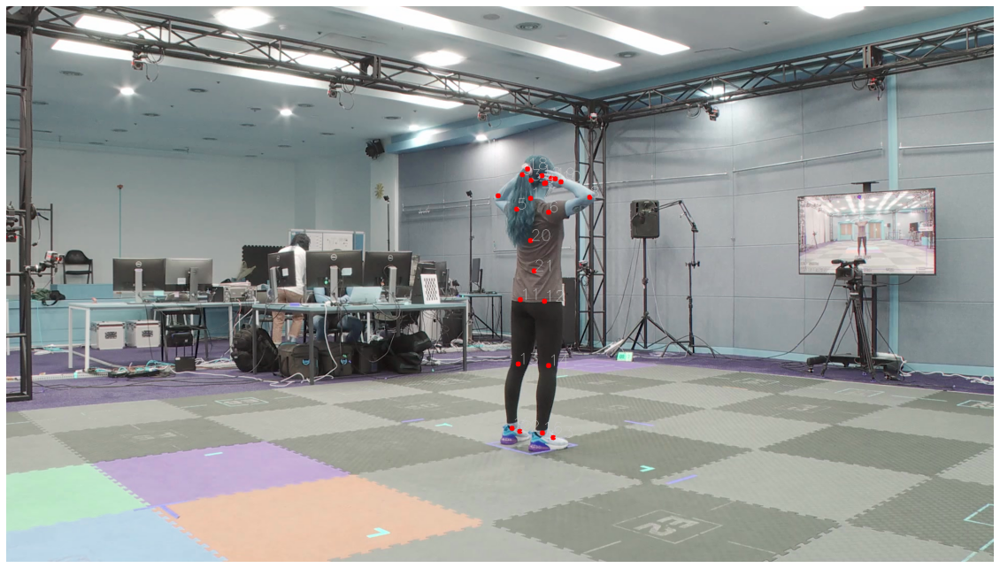

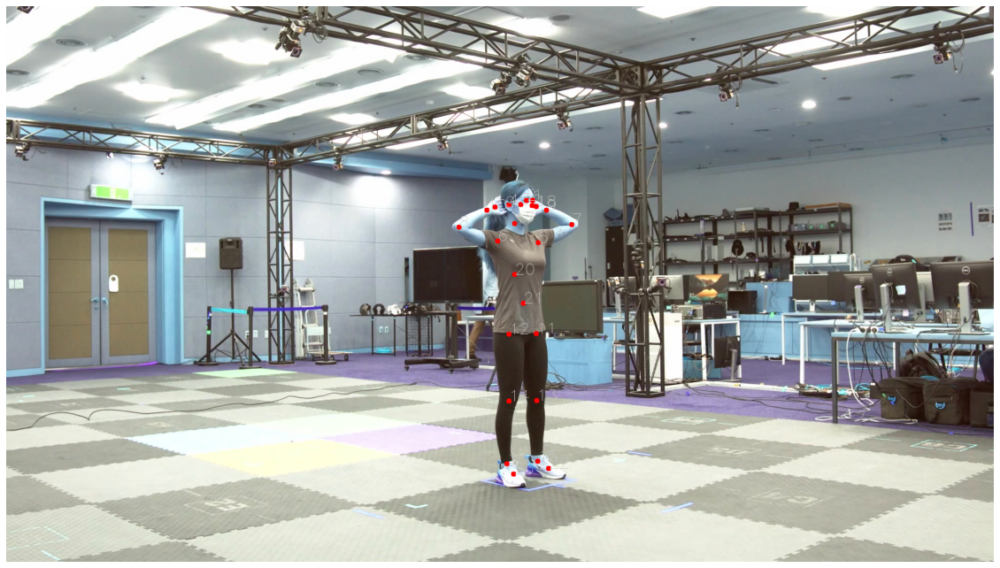

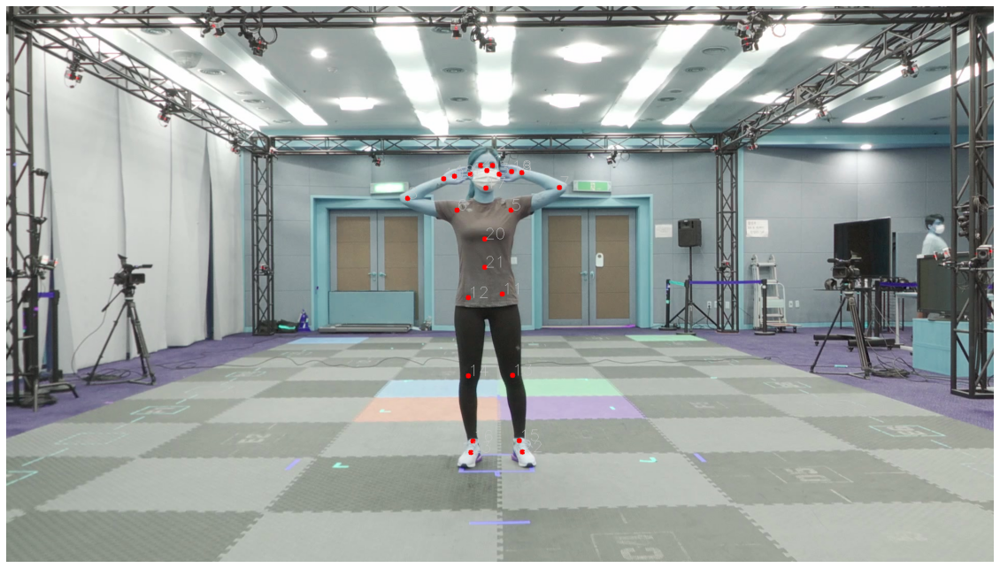

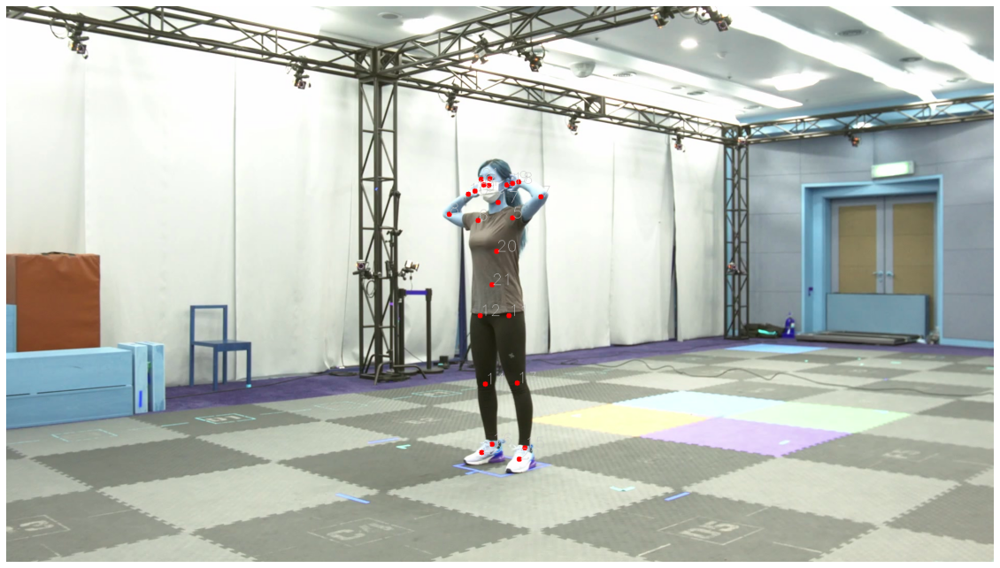

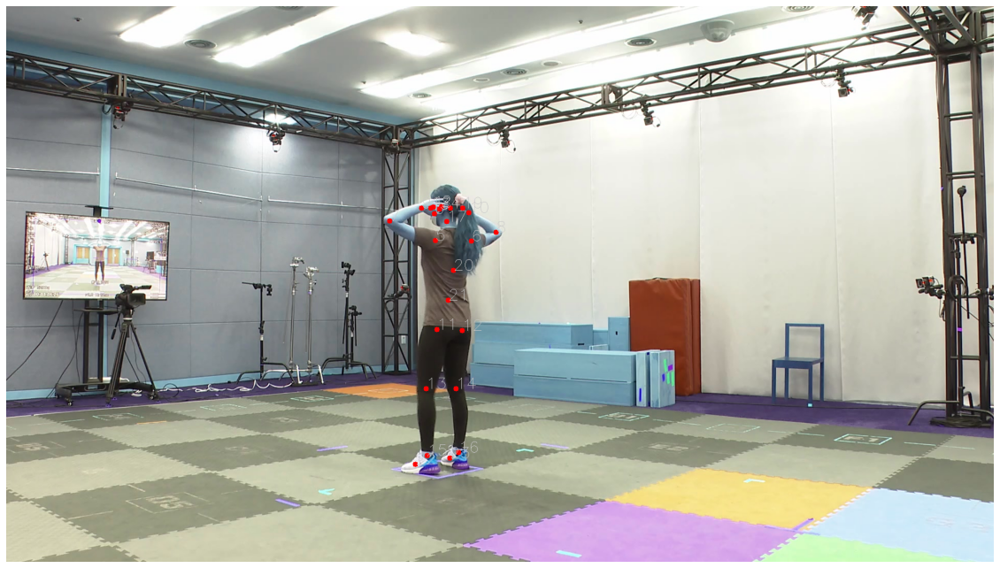

...

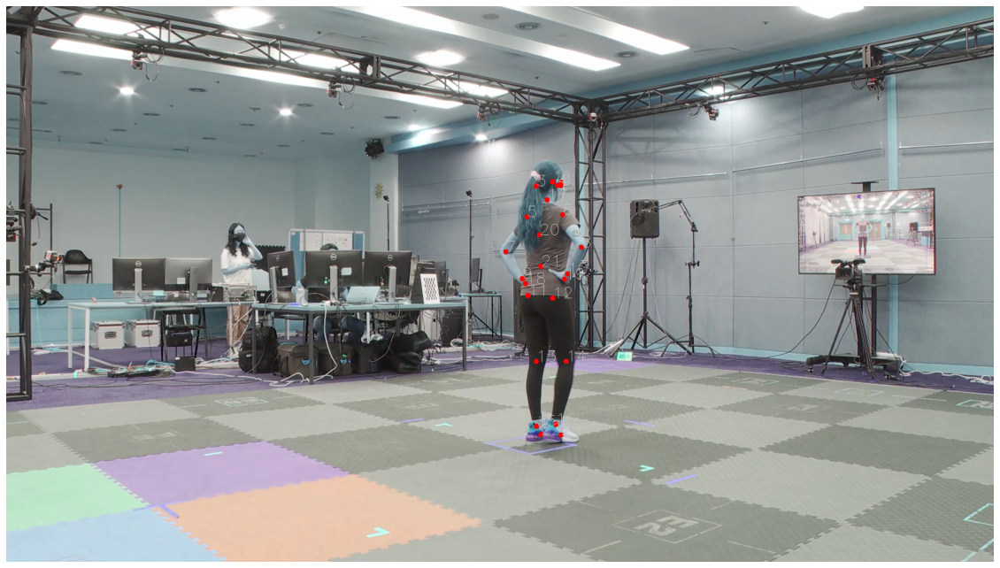

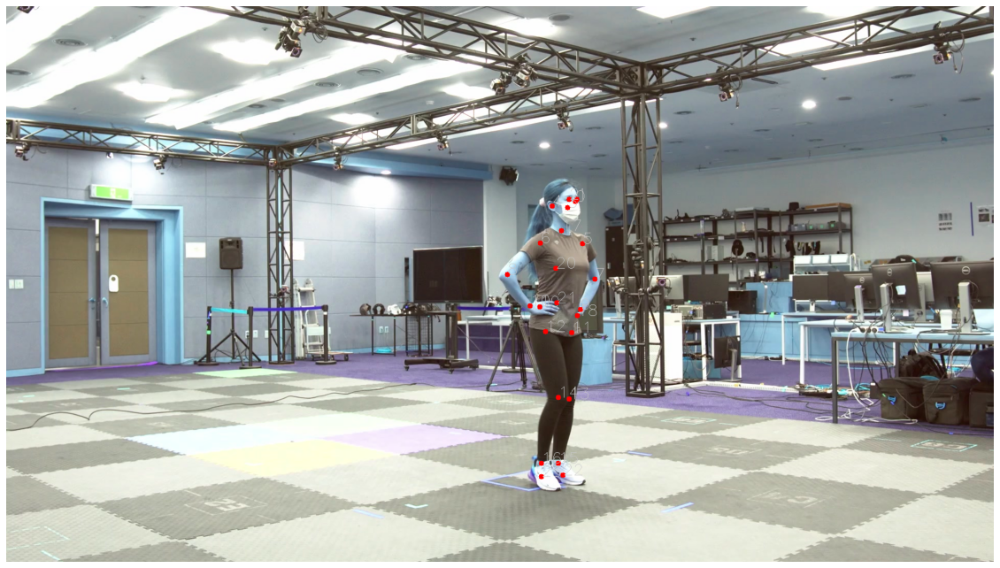

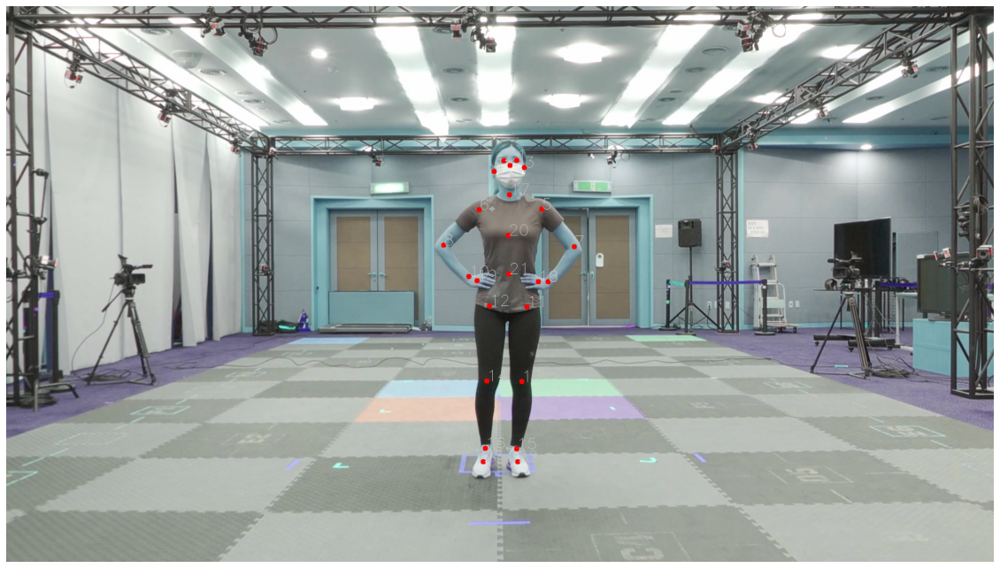

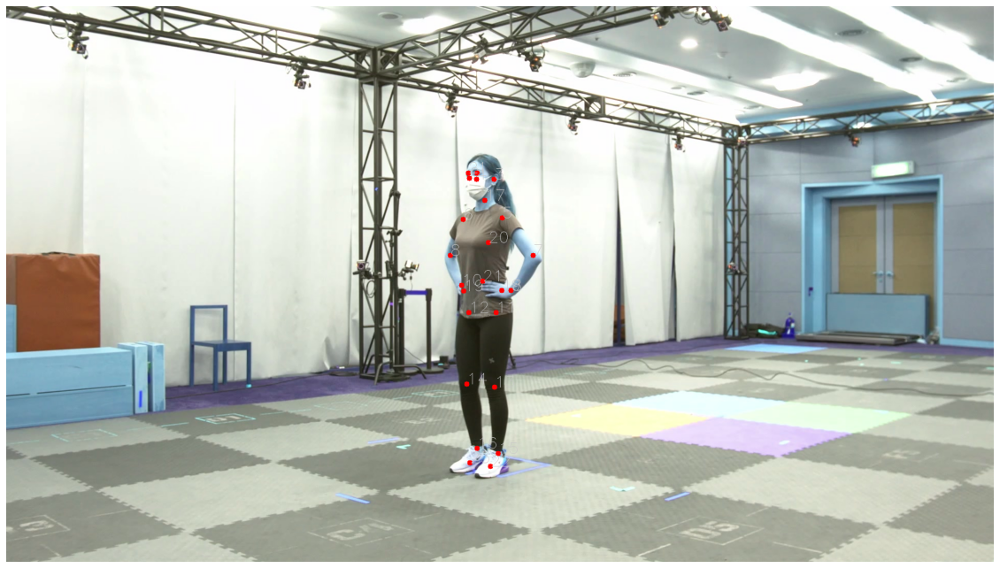

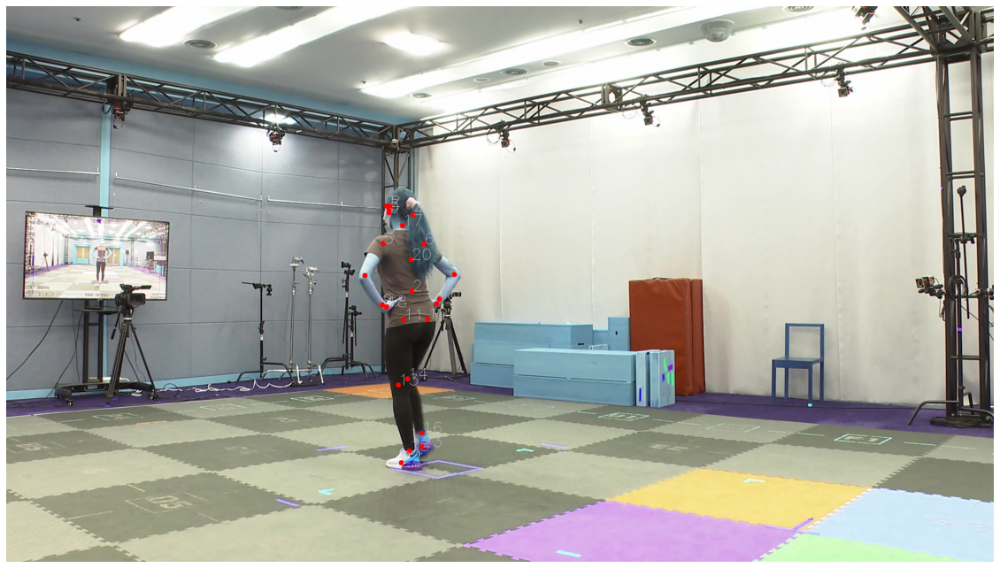

In [7]:
# print(next(number_it))
vis_keypoints(train_dir, target_list[:20], 'data/train_df_modified.csv')

In [8]:
error_list = []
for file in train_list:
    if '642-2-4-31-Z148' in file:
        error_list.append(file)

In [9]:
# print(next(number_it))
vis_keypoints(train_dir, error_list, 'data/train_df.csv')

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x7fab54ad4170> (for post_execute):



KeyboardInterrupt



In [ ]:
df = pd.read_csv('data/train_df.csv')
columns = df.columns[1:].to_list()[::2]
class_labels = [label.replace('_x', '').replace('_y', '') for label in columns]
print([(i, c) for i, c in enumerate(class_labels)])

In [ ]:
vis_keypoints(train_dir, error_list, 'data/train_df.csv')